<table>
<tr>                                                                                   
     <th>
         <div style='padding:15px;color:#030aa7;font-size:240%;text-align: center;font-style: italic;font-weight: bold;font-family: Georgia, serif'><a href="https://www.kaggle.com/datasets/alicenkbaytop/abalone-dataset/data">Jeu de données Abalone</a></div>
     </th>
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/abalone.jpg" width="96"></th>
 </tr>
<tr>                                                                                   
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/abalone01.jpg" width="512"></th>
 </tr>    
</table>


<div style='padding:15px;color:#030aa7;font-size:100%;text-align: left;font-family: Georgia, serif'><a href="https://archive.ics.uci.edu/dataset/1/abalone">Veuillez vous référer à la page UC Irvine Machine Learning Repository officielle pour plus de détails.</a></div>

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Introduction</div></b>
## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Import libriries </div></b>

In [1]:
import pandas as pd, numpy as np, seaborn as sns, warnings, os
from datetime import datetime as dt
from matplotlib import pyplot as plt

import matplotlib.font_manager as fm
import plotly.express as px
import plotly.graph_objs as go
# import graphviz, pydotplus
from IPython.display import Image
import re

font1 = fm.FontProperties(size=20)
font2 = fm.FontProperties(size=24)

warnings.filterwarnings(action="ignore")

if int(str(sns.__version__).split('.')[1]) > 8 : 
    plt.style.use('seaborn-v0_8-darkgrid')
else:
    plt.style.use('seaborn-darkgrid')
sns.set(font_scale=3)

In [2]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import fcluster
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from sklearn.tree import DecisionTreeClassifier,export_graphviz

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Outils du document</div></b>

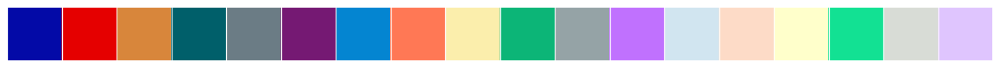

In [3]:
palette = [ "#030aa7", "#e50000", "#d8863b", "#005f6a", "#6b7c85", "#751973", 
            "#0485d1", "#ff7855", "#fbeeac", "#0cb577", "#95a3a6", "#c071fe", 
            "#d1e5f0", "#fddbc7", "#ffffcb", "#12e193", "#d8dcd6", "#dfc5fe", 
          ]
sns.palplot(sns.color_palette(palette))

In [4]:
repertoireRacine  = '.'
nomProjet         = "Abalone"

repertoireProjet  = os.path.join(repertoireRacine, nomProjet)
repertoireDonnees = os.path.join(repertoireProjet, 'repertoire.donnees')
repertoireImages  = os.path.join(repertoireProjet, 'repertoire.images')


def controleExistenceRepertoire( repertoire, create_if_needed=True):
    """Voir si le répertoire existe. S'il n'existe pas il est créé."""
    path_exists = os.path.exists(repertoire)
    if path_exists:
        if not os.path.isdir(repertoire):
            raise Exception("Trouvé le nom  "+repertoire +" mais c'est un fichier, pas un répertoire")
            # return False
        return True
    if create_if_needed:
        os.makedirs(repertoire)

def sauvegarderImage( fichier):
    """Enregistrez la figure. Appelez la méthode juste avant plt.show ()."""
    controleExistenceRepertoire(repertoireImages)
    plt.savefig(os.path.join(repertoireImages,
                             fichier+f"--{dt.now().strftime('%Y_%m_%d_%H.%M.%S')}.png"), 
                             dpi=600, 
                             bbox_inches='tight')

def sauvegarderImageSNS( sns_plot, fichier):
    """Enregistrez la figure. Appelez la méthode juste avant plt.show ()."""
    controleExistenceRepertoire(repertoireImages)
    fig = sns_plot.get_figure()
    fig.savefig(os.path.join(repertoireImages,fichier+'.png'))
    
controleExistenceRepertoire(repertoireProjet);
controleExistenceRepertoire(repertoireDonnees);
controleExistenceRepertoire(repertoireImages);

In [5]:
def formatPct(pct, allvals):
    total = int(round(pct/100. * np.sum(allvals)))
    return "{:.2f}%\n({:d})".format(pct, total)   

In [6]:
def affichageDistribution(colonne,couleur,ax, nom=''):
    graph = sns.distplot(colonne, color=couleur, ax=ax)
    graph.set(ylabel=None)
    moyenne, mediane = float(colonne.mean()), \
                   float(colonne.median())
    
    ax.axvline(moyenne, color='g', linestyle='-', label=f"{nom:12s} mean   = {moyenne:0.4f}", lw=2)
    ax.axvline(mediane, color='b', linestyle='--', label=f"{nom:12s} median = {mediane:0.4f}", lw=2)
    graph.legend(loc="upper right")

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Lecture des données</div></b>

In [7]:
donnees = pd.read_csv("../donnees/abalone.csv").iloc[:,1:]
donnees.sample(5)

,Sex,Longueur,Diametre,Hauteur,Poids.Entier,Poids.Decortique,Poids.Visceres,Poids.Coquille,Anneaux
1499,F,0.630,0.500,0.175,1.1105,0.4670,0.2680,0.3290,10
2665,M,0.580,0.455,0.130,0.8520,0.4100,0.1725,0.2250,8
1191,M,0.700,0.565,0.180,1.7510,0.8950,0.3355,0.4460,9
377,M,0.565,0.465,0.175,0.9950,0.3895,0.1830,0.3700,15
3400,M,0.480,0.395,0.150,0.6815,0.2145,0.1405,0.2495,18


In [8]:
donnees.columns

Index(['Sex', 'Longueur', 'Diametre', 'Hauteur', 'Poids.Entier',
       'Poids.Decortique', 'Poids.Visceres', 'Poids.Coquille', 'Anneaux'],
      dtype='object')

In [9]:
qualitatives = ['Sex', 'Anneaux']
quantitatives = ['Longueur', 'Diametre', 'Hauteur', 'Poids.Entier', 'Poids.Decortique', 'Poids.Visceres', 'Poids.Coquille']

In [10]:
donnees.Anneaux.sort_values().unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29], dtype=int64)

In [11]:
donnees.describe()

,Longueur,Diametre,Hauteur,Poids.Entier,Poids.Decortique,Poids.Visceres,Poids.Coquille,Anneaux
count,4176.000000,4176.000000,4176.000000,4176.000000,4176.00000,4176.000000,4176.000000,4176.000000
mean,0.524009,0.407892,0.139527,0.828818,0.35940,0.180613,0.238852,9.932471
std,0.120103,0.099250,0.041826,0.490424,0.22198,0.109620,0.139213,3.223601
min,0.075000,0.055000,0.000000,0.002000,0.00100,0.000500,0.001500,1.000000
25%,0.450000,0.350000,0.115000,0.441500,0.18600,0.093375,0.130000,8.000000
50%,0.545000,0.425000,0.140000,0.799750,0.33600,0.171000,0.234000,9.000000
75%,0.615000,0.480000,0.165000,1.153250,0.50200,0.253000,0.329000,11.000000
max,0.815000,0.650000,1.130000,2.825500,1.48800,0.760000,1.005000,29.000000


# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Statistiques descriptives et analyse de données</div></b>

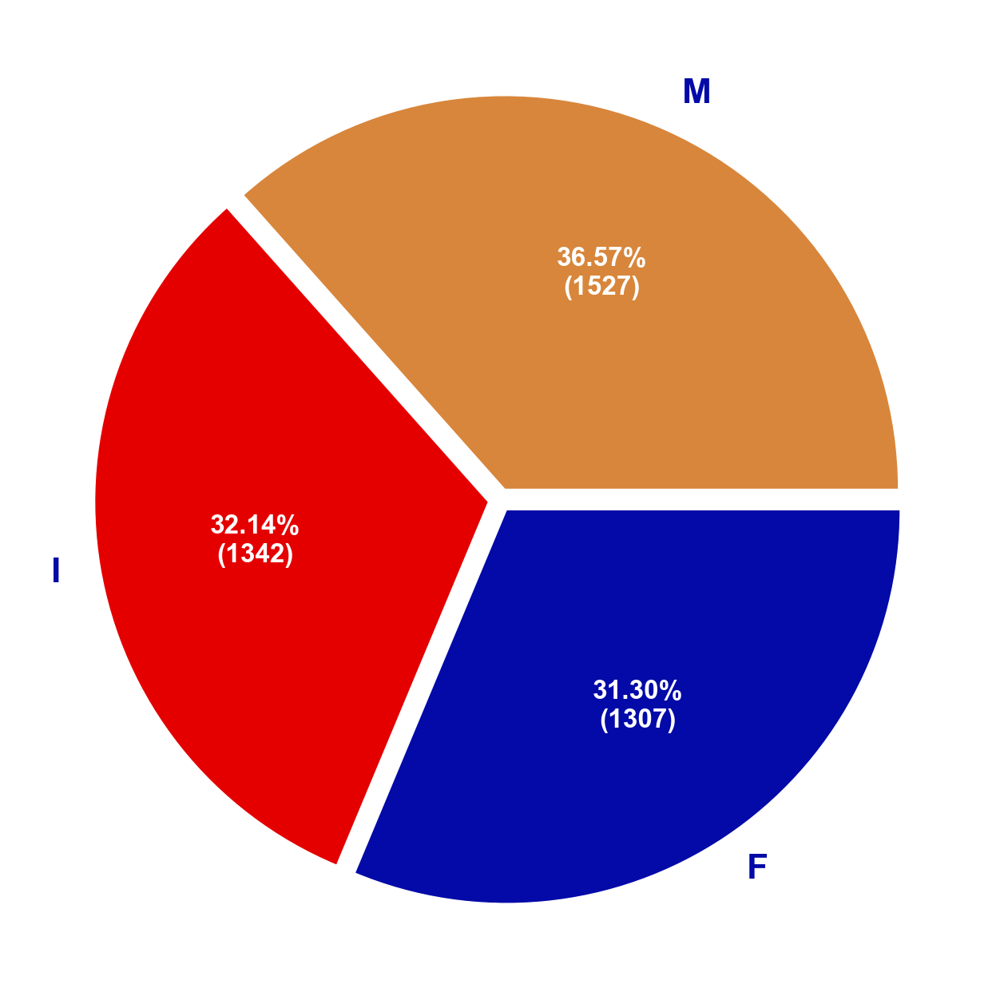

In [12]:
radius,size=0.8,0.3
fig,ax = plt.subplots(ncols=1,figsize=(16,16), subplot_kw=dict(aspect="equal"))

affichage = donnees.groupby('Sex').Anneaux.count().reset_index().rename(columns={'Anneaux':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage

wedges, texts, autotexts =  ax.pie(
         affichage['nombre'],
         autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
         labels=affichage.Sex.values,
         # shadow=True, 
         counterclock=False,
         startangle=0 ,
         colors = palette,
         # pctdistance=0.4, 
         labeldistance=1.1, 
         textprops=dict(color="#030aa7"),
         explode=(0.03,0.03,0.03)
      );
plt.setp(autotexts, size=24, weight="bold",color="w")
plt.setp(texts, size=32, weight="bold");

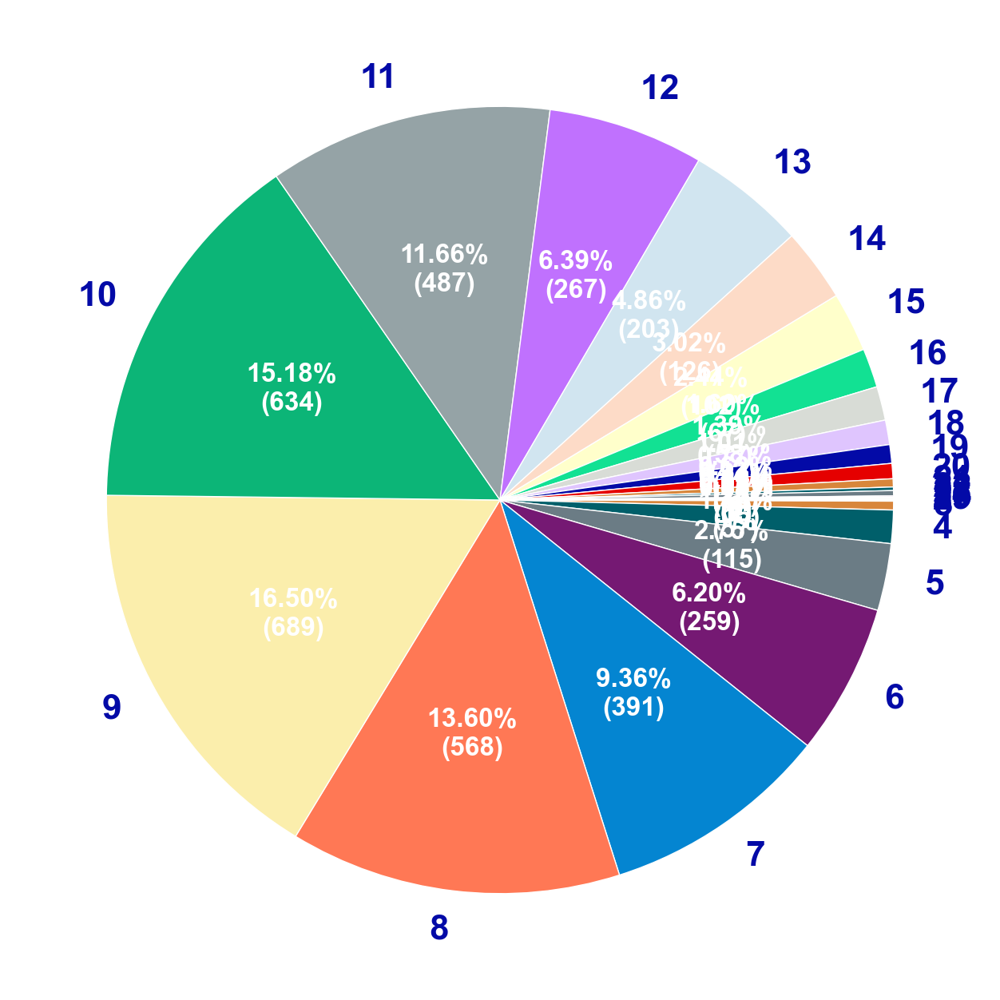

In [13]:
radius,size=0.8,0.3
fig,ax = plt.subplots(ncols=1,figsize=(16,16), subplot_kw=dict(aspect="equal"))

affichage = donnees.groupby('Anneaux').Sex.count().reset_index().rename(columns={'Sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage

wedges, texts, autotexts =  ax.pie(
         affichage['nombre'],
         autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
         labels=affichage.Anneaux,
         # shadow=True, 
         counterclock=False,
         startangle=0 ,
         colors = palette,
         # pctdistance=0.4, 
         labeldistance=1.1, 
         textprops=dict(color="#030aa7"),
         # explode=(0.03,0.03,0.03)
      );
plt.setp(autotexts, size=24, weight="bold",color="w")
plt.setp(texts, size=32, weight="bold");

In [14]:
donnees['AnneauxQ'] = pd.qcut(donnees.Anneaux, 4, labels=["petit", "moyen","grand","très grand"])

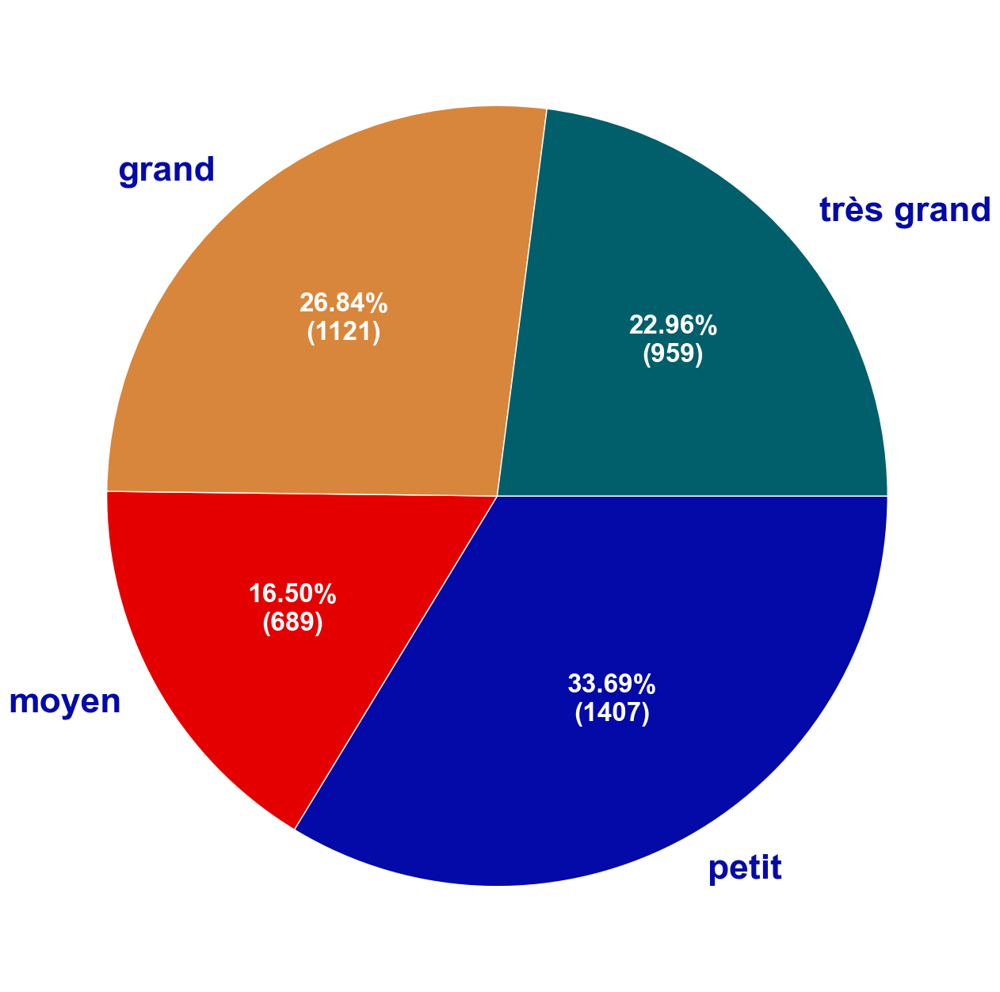

In [15]:
radius,size=0.8,0.3
fig,ax = plt.subplots(ncols=1,figsize=(16,16), subplot_kw=dict(aspect="equal"))

affichage = donnees.groupby('AnneauxQ').Sex.count().reset_index().rename(columns={'Sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage

wedges, texts, autotexts =  ax.pie(
         affichage['nombre'],
         autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
         labels=affichage.AnneauxQ,
         # shadow=True, 
         counterclock=False,
         startangle=0 ,
         colors = palette,
         # pctdistance=0.4, 
         labeldistance=1.1, 
         textprops=dict(color="#030aa7"),
         # explode=(0.03,0.03,0.03)
      );
plt.setp(autotexts, size=24, weight="bold",color="w")
plt.setp(texts, size=32, weight="bold");

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Corrélation de Pearson</div></b>

<table>        
<tr>                                                                                   
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/rmse.png" ></th>
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/rse.png" ><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/correlation_pearson.png" ></th>
</tr> 
</table>
<img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/correlation_pearson_graphs.png" width="1024">

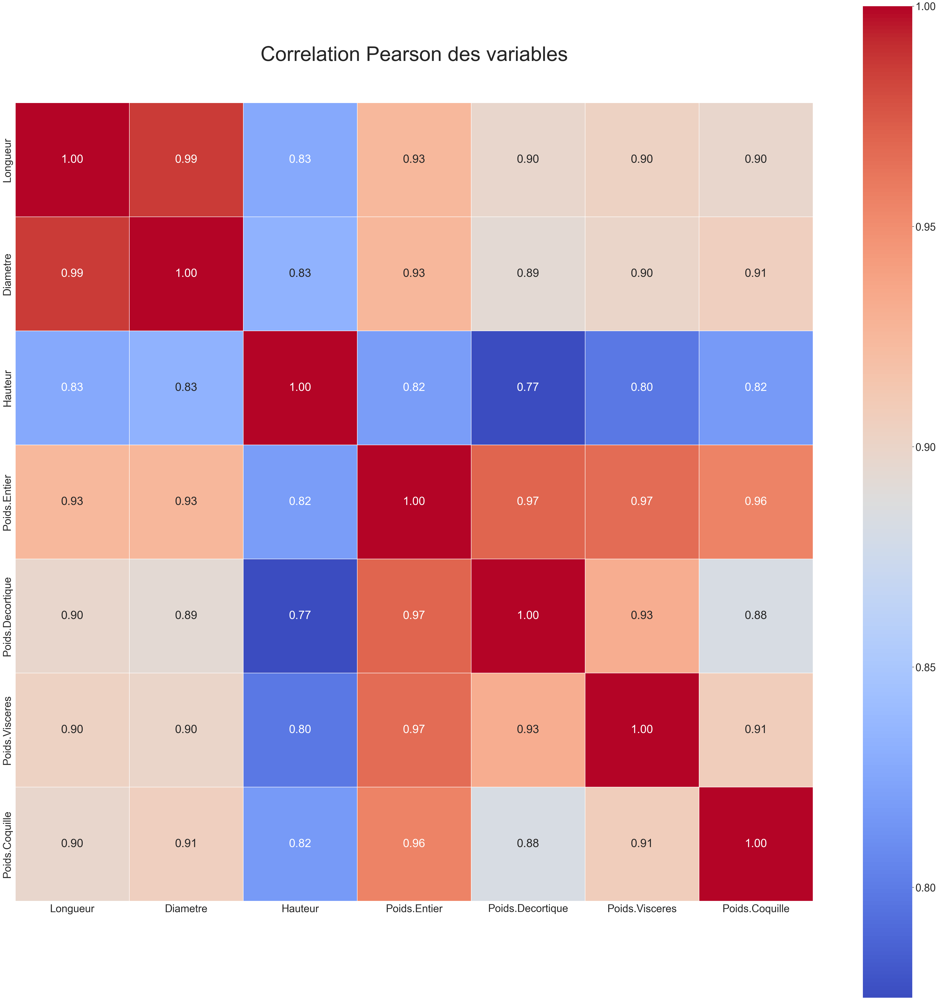

In [16]:
plt.figure(figsize=(56,56))
sns.set(font_scale=3)
plt.title('Correlation Pearson des variables', y=1.05, size=64)
sns.heatmap(donnees[quantitatives].corr(),linewidths=0.3, fmt= '.2f', #vmax=1.0, 
            square=True, cmap='coolwarm', linecolor='white', annot=True)
# sauvegarderImage('Correlation Pearson des variables')   
sns.set(font_scale=2)

In [17]:
donneesM = donnees.melt(id_vars=['Sex','Anneaux','AnneauxQ'], 
                        value_vars=['Longueur', 'Diametre', 'Hauteur', 'Poids.Entier',
                                    'Poids.Decortique', 'Poids.Visceres', 'Poids.Coquille'])

In [18]:
donneesM.head()

,Sex,Anneaux,AnneauxQ,variable,value
0,M,7,petit,Longueur,0.350
1,F,9,moyen,Longueur,0.530
2,M,10,grand,Longueur,0.440
3,I,7,petit,Longueur,0.330
4,I,8,petit,Longueur,0.425


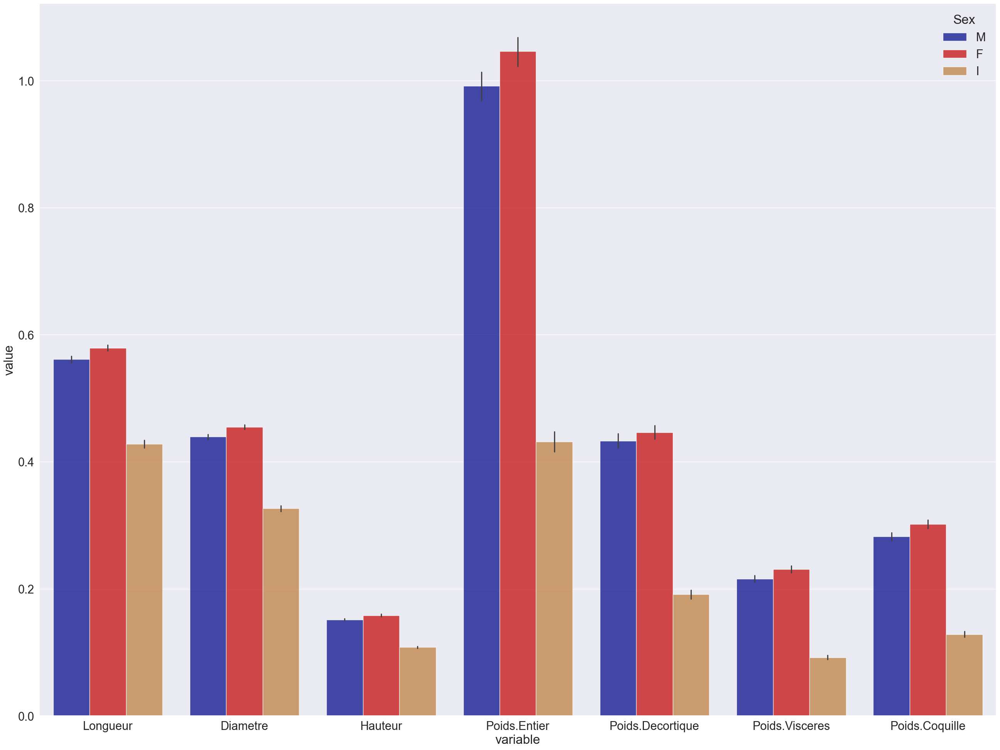

In [19]:
plt.figure(figsize=(32,24))
gbarplot = sns.barplot(x='variable',y='value',hue='Sex', data=donneesM,palette=palette,alpha=0.8,estimator='mean')

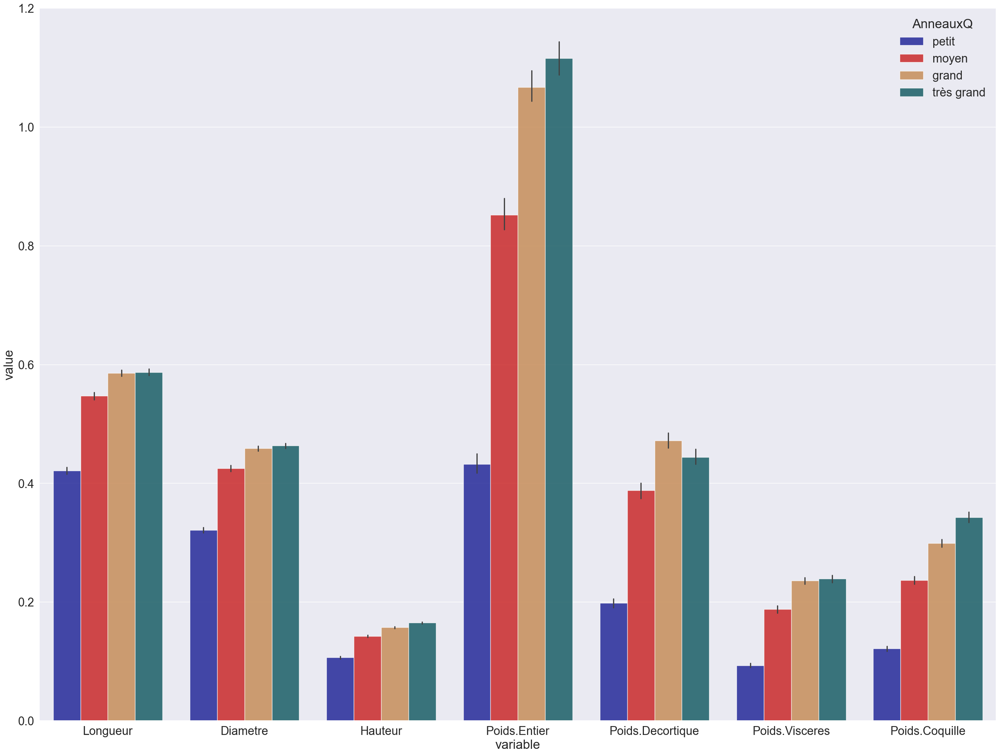

In [20]:
plt.figure(figsize=(32,24))
gbarplot = sns.barplot(x='variable',y='value',hue='AnneauxQ', data=donneesM,palette=palette,alpha=0.8,estimator='mean')

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Les distributions des variables quantitatives</div></b>

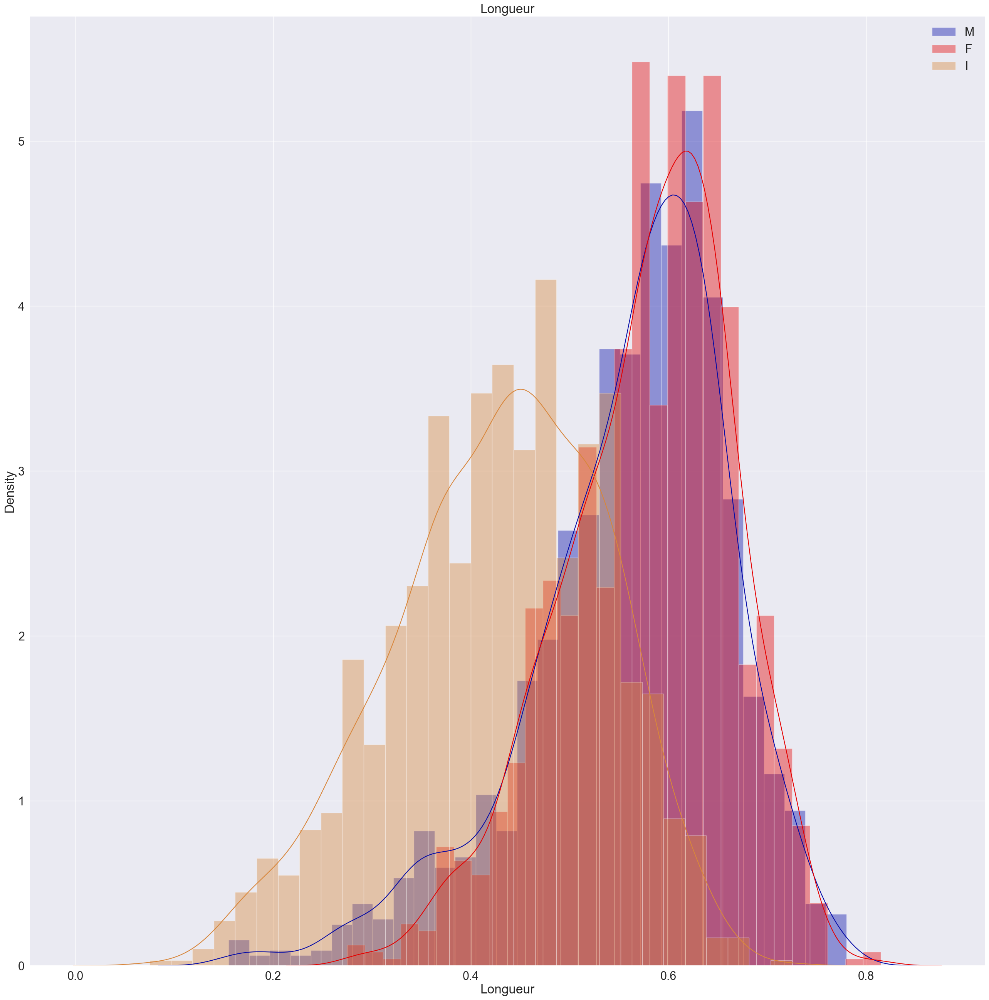

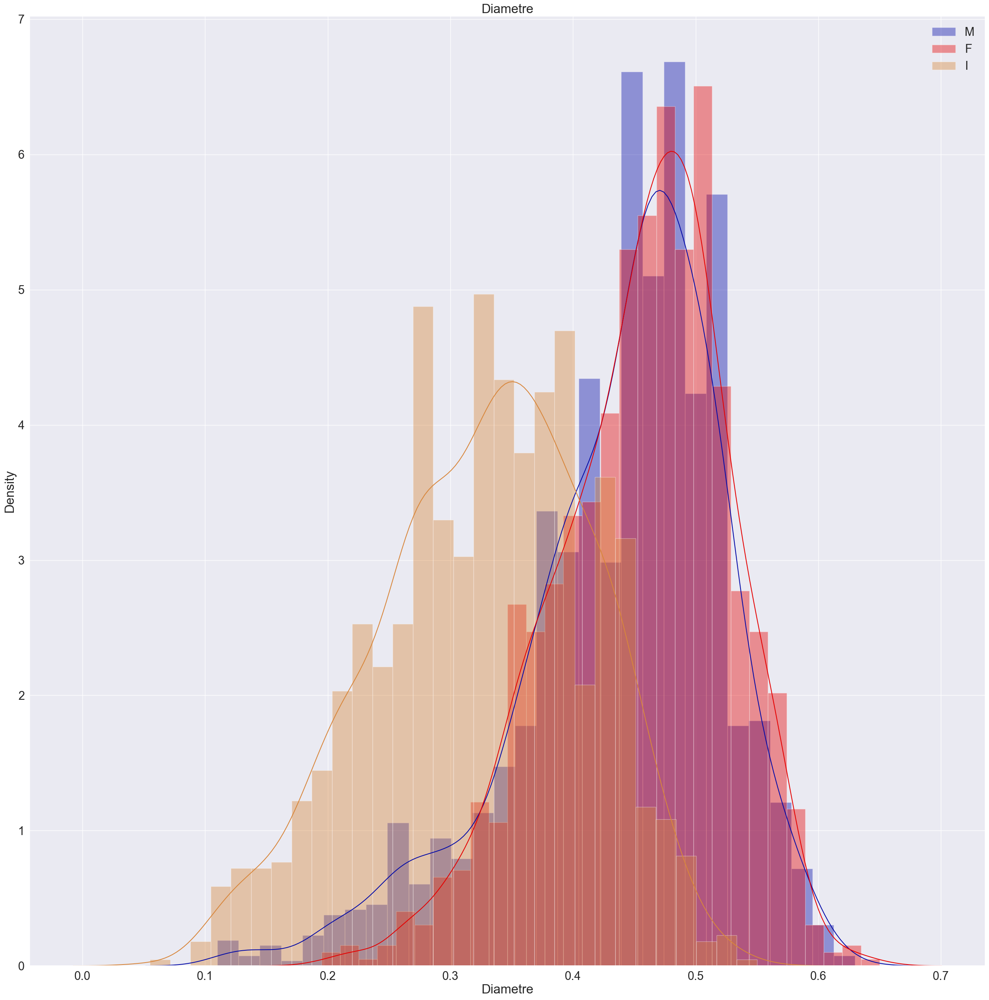

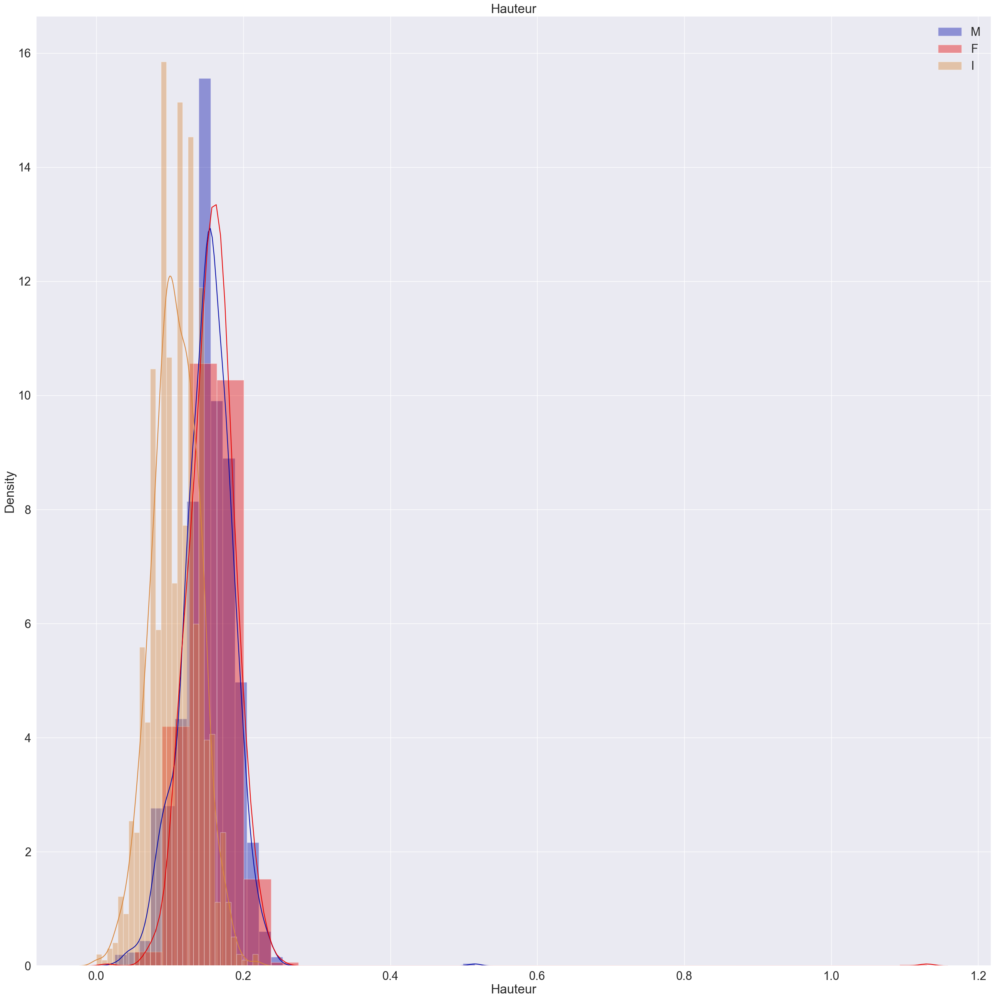

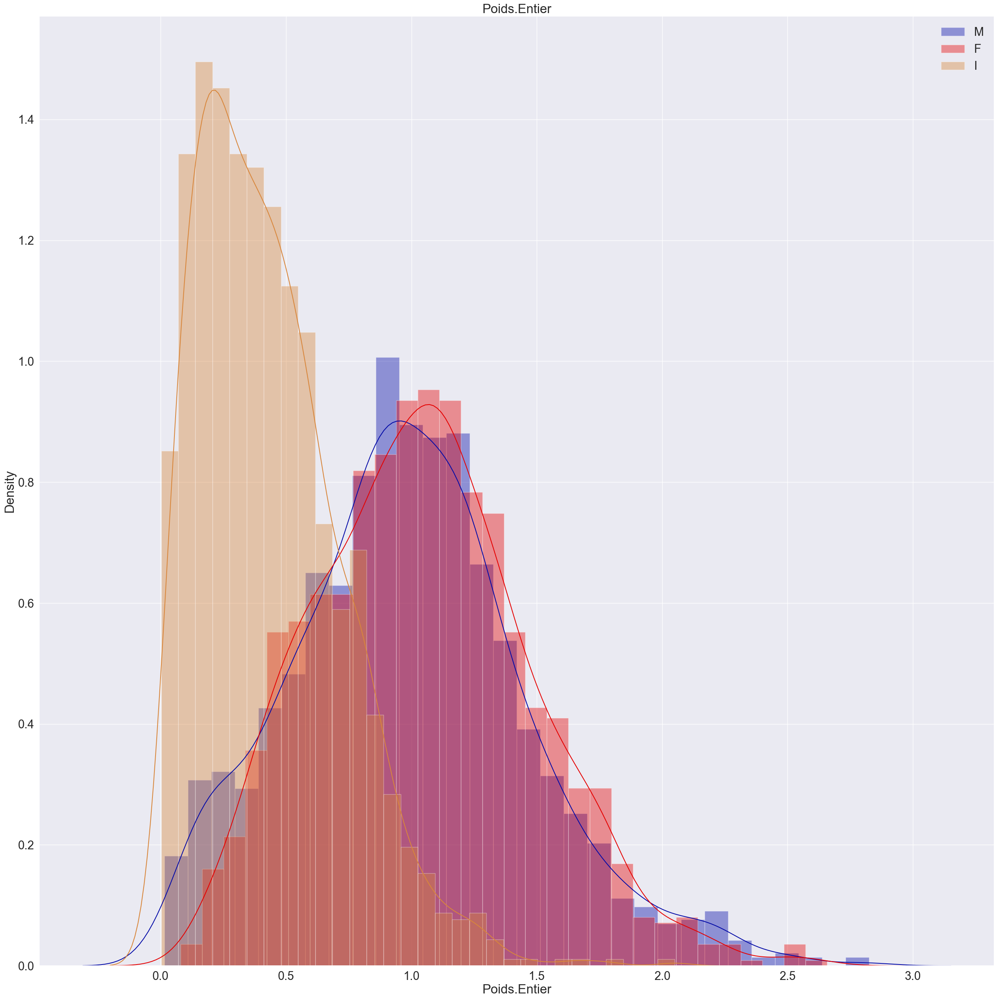

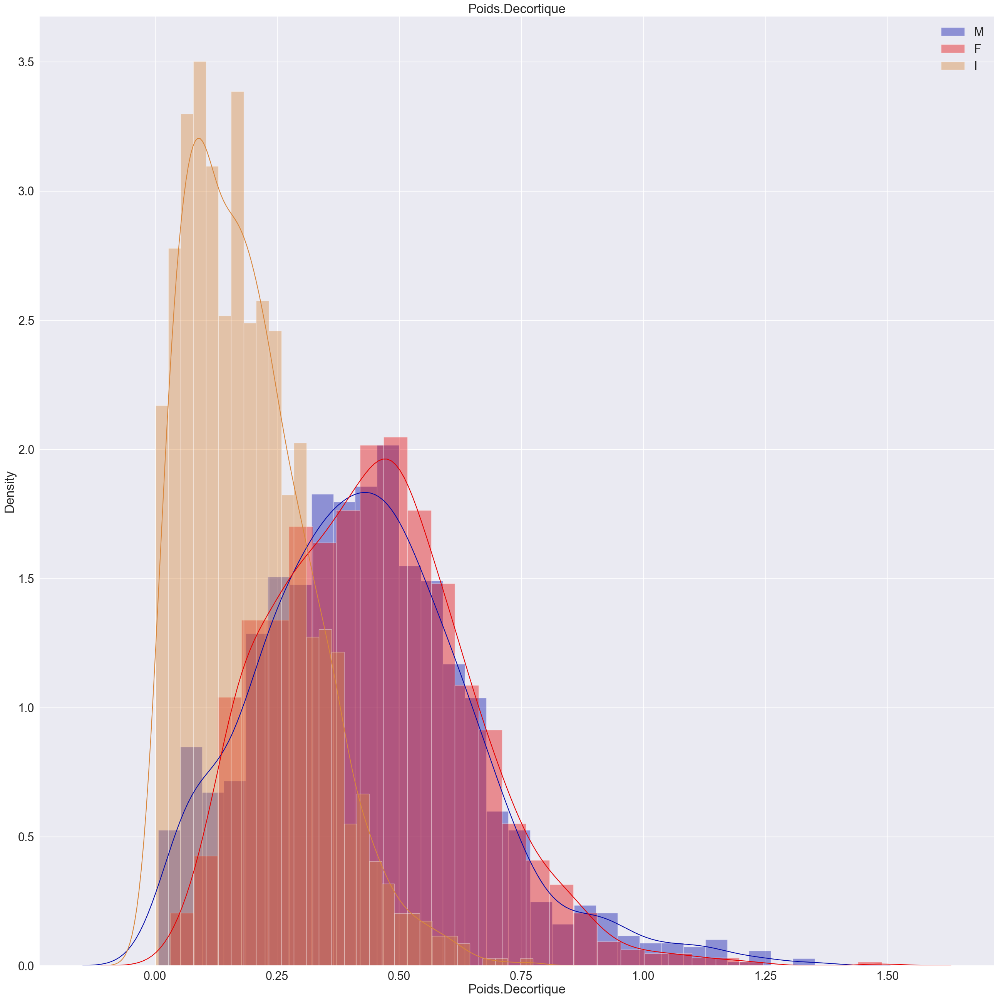

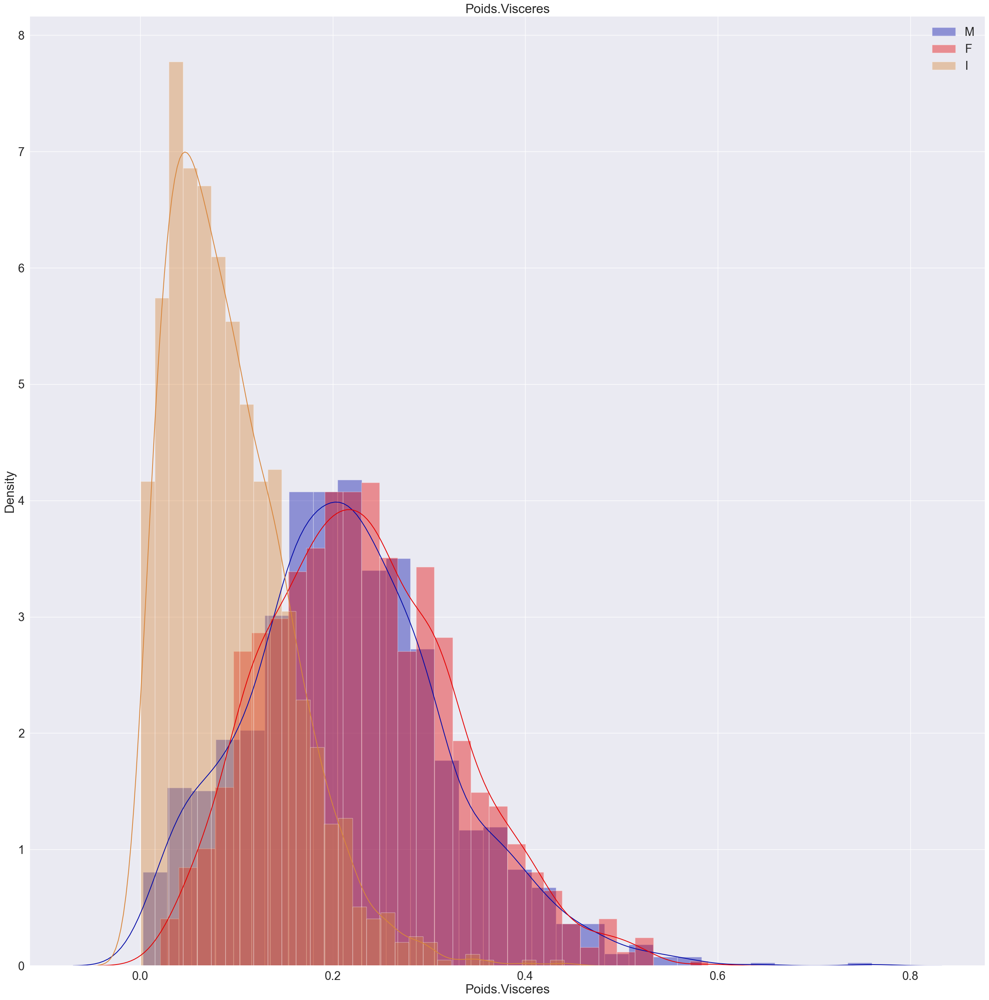

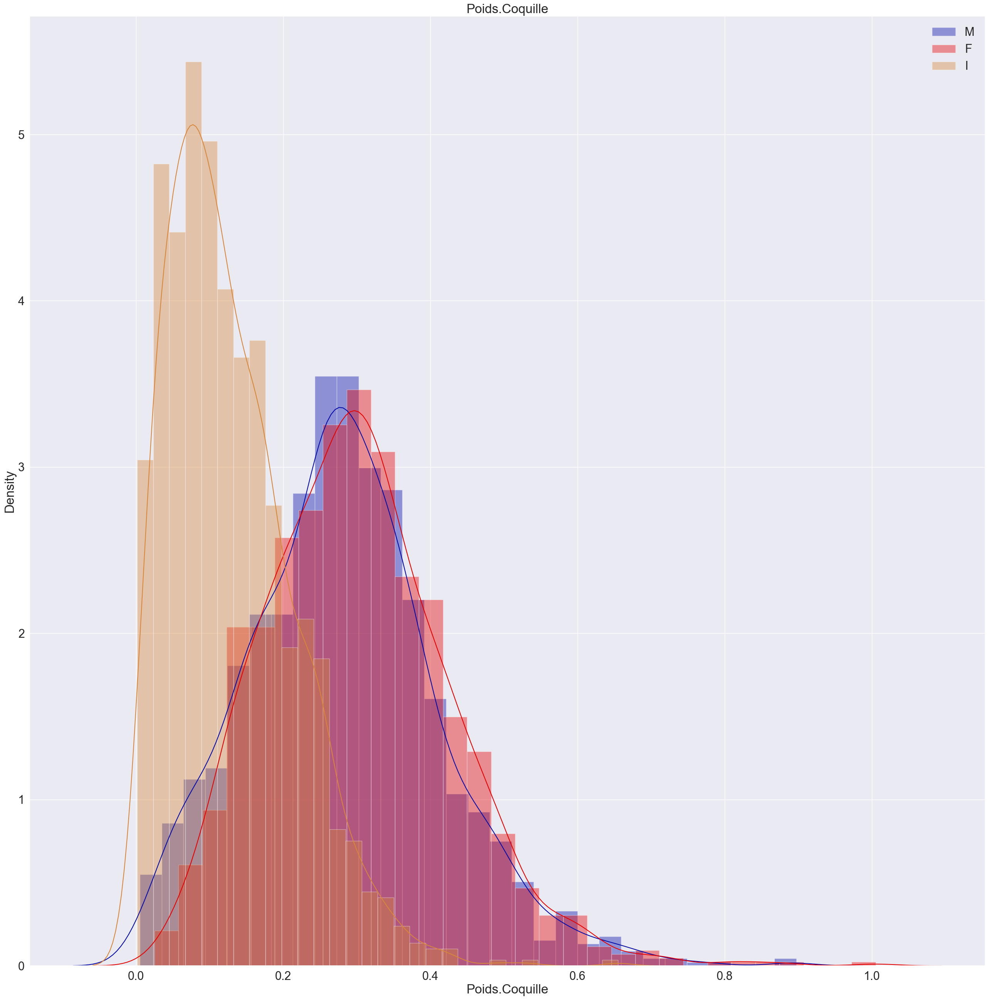

In [21]:
for colonne in quantitatives:
    plt.figure(figsize=(32,32))
    plt.title(colonne)
    sns.distplot(donnees[colonne][donnees.Sex == 'M'],color=palette[0], label='M', hist_kws=dict(alpha=0.4),bins=30)
    sns.distplot(donnees[colonne][donnees.Sex == 'F'],color=palette[1], label='F', hist_kws=dict(alpha=0.4),bins=30)
    sns.distplot(donnees[colonne][donnees.Sex == 'I'],color=palette[2], label='I', hist_kws=dict(alpha=0.4),bins=30)
    plt.legend();    

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Pair Plot</div></b>

In [22]:
affichage = donnees[quantitatives].copy()
affichage['Sex'] = donnees['Sex']

graph = sns.pairplot(
             affichage,
             hue='Sex', 
             size=12, 
             aspect=1, 
             palette=palette,
             plot_kws={"s": 1200,"alpha":0.6}, 
             markers=["o", "s", "^"],   
             # corner=True, 
             diag_kind="kde")
graph.map_upper(sns.kdeplot, levels=24, color=".2");
graph._legend.remove()
graph.add_legend(fontsize='xx-large', title_fontsize='xx-large');
# sauvegarderImage('SantéFœtale-pairplot')

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Centrage et réduction des données</div></b>
<table>
<tr>
<th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/moyenne.png"></th>
<th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/ecart_type.png"></th>
<th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/centrage_reduction.png"></th>
</tr>
</table>

In [23]:
from sklearn.preprocessing import StandardScaler
modelStd = StandardScaler()
# modelStd.fit(donnees[quantitatives])
# donnees[quantitatives] = modelStd.transform(donnees[quantitatives])
donnees[quantitatives] = modelStd.fit_transform(donnees[quantitatives])

In [24]:
donnees['AnneauxQ'] = pd.qcut(donnees.Anneaux, 4, labels=["petit", "moyen","grand","très grand"])

In [25]:
donneesM = donnees.melt(id_vars=['Sex','Anneaux','AnneauxQ'], value_vars=['Longueur', 'Diametre', 'Hauteur', 'Poids.Entier',
                                    'Poids.Decortique', 'Poids.Visceres', 'Poids.Coquille'])

In [26]:
donneesM.head()

,Sex,Anneaux,AnneauxQ,variable,value
0,M,7,petit,Longueur,-1.449007
1,F,9,moyen,Longueur,0.049892
2,M,10,grand,Longueur,-0.699558
3,I,7,petit,Longueur,-1.615552
4,I,8,petit,Longueur,-0.824466


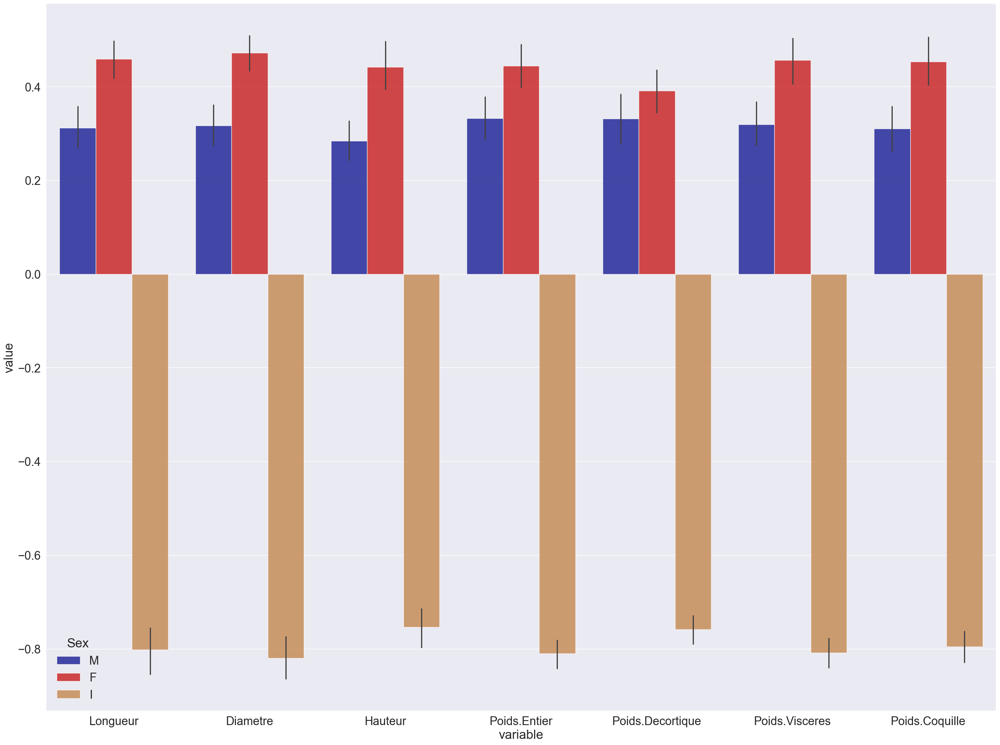

In [27]:
plt.figure(figsize=(32,24))
gbarplot = sns.barplot(x='variable',y='value',hue='Sex', data=donneesM,palette=palette,alpha=0.8,estimator='mean')

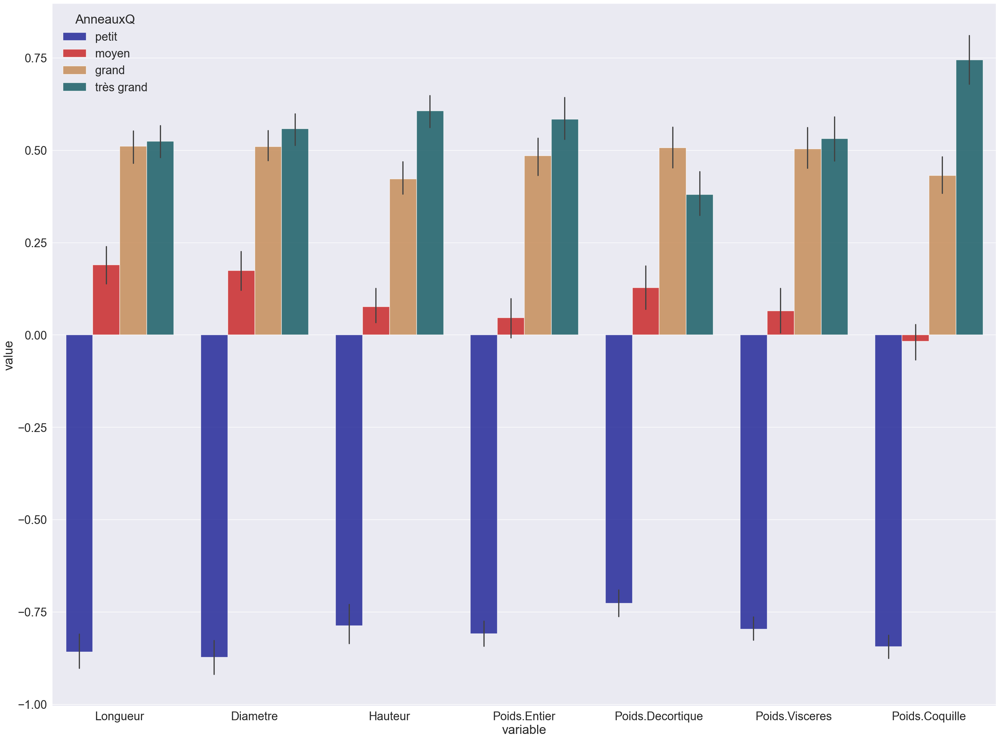

In [28]:
plt.figure(figsize=(32,24))
gbarplot = sns.barplot(x='variable',y='value',hue='AnneauxQ', data=donneesM,palette=palette,alpha=0.8,estimator='mean')